In [5]:
import sys
sys.path.insert(0, '..')

import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
import joblib
from datetime import datetime
import os
import matplotlib.pyplot as plt
from scipy import stats
from tqdm import tqdm

from core.final.dataset import PSMDataset

In [7]:
CLASSES = ['EW', 'SR', 'EA', 'RRAB', 'EB', 'ROT', 'RRC', 'HADS', 'M', 'DSCT']

METADATA_COLS = [
    'mean_vmag',  'phot_g_mean_mag', 'e_phot_g_mean_mag', 'phot_bp_mean_mag', 'e_phot_bp_mean_mag', 'phot_rp_mean_mag', 'e_phot_rp_mean_mag',
    'bp_rp', 'parallax', 'parallax_error', 'parallax_over_error', 'pmra', 'pmra_error', 'pmdec',
    'pmdec_error', 'j_mag', 'e_j_mag', 'h_mag', 'e_h_mag', 'k_mag', 'e_k_mag', 'w1_mag', 'e_w1_mag',
    'w2_mag', 'e_w2_mag', 'w3_mag', 'w4_mag', 'j_k', 'w1_w2', 'w3_w4', 'pm', 'ruwe', 'l', 'b'
]

PHOTO_COLS = ['amplitude', 'period', 'lksl_statistic', 'rfr_score']

METADATA_FUNC = {
    "abs": [
        "mean_vmag",
        "phot_g_mean_mag",
        "phot_bp_mean_mag",
        "phot_rp_mean_mag",
        "j_mag",
        "h_mag",
        "k_mag",
        "w1_mag",
        "w2_mag",
        "w3_mag",
        "w4_mag",
    ],
    "cos": ["l"],
    "sin": ["b"],
    "log": ["period"]
}

In [55]:
def get_config():
    config = {
        'project': 'AstroCLIPResults',
        'mode': 'meta',    # 'clip' 'photo' 'spectra' 'meta' 'all'
        'config_from': None,    # 'meridk/AstroCLIPResults/zgfcm56p',
        'random_seed': 42,  # 42, 66, 0, 12, 123
        'use_wandb': True,
        'save_weights': True,
        'weights_path': f'/home/mariia/AstroML/weights/{datetime.now().strftime("%Y-%m-%d-%H-%M")}',
        # 'use_pretrain': 'CLIP/home/mariia/AstroML/weights/2024-08-14-14-05-zmjau1cu/weights-51.pth',
        'use_pretrain': None,
        'freeze': False,

        # Data General
        'data_root': '/home/mariia/AstroML/data/asassn/',
        'file': 'preprocessed_data/full_lb/spectra_and_v',
        'classes': None,
        'num_classes': None,
        'meta_cols': METADATA_COLS,
        'photo_cols': PHOTO_COLS,
        'min_samples': None,
        'max_samples': None,

        # Photometry
        'v_zip': 'asassnvarlc_vband_complete.zip',
        'v_prefix': 'vardb_files',
        'seq_len': 200,
        'phased': False,
        'p_aux': True,

        # Spectra
        'lamost_spec_dir': 'Spectra/v2',
        's_mad': True,
        's_aux': True,
        's_err': True,

        # Photometry Model
        'p_enc_in': 3,
        'p_d_model': 128,
        'p_dropout': 0.2,
        'p_factor': 1,
        'p_output_attention': False,
        'p_n_heads': 4,
        'p_d_ff': 512,
        'p_activation': 'gelu',
        'p_e_layers': 8,

        # Spectra Model
        's_dropout': 0.2,
        's_conv_channels': [1, 64, 64, 32, 32],
        's_kernel_size': 3,
        's_mp_kernel_size': 4,

        # Metadata Model
        'm_hidden_dim': 512,
        'm_dropout': 0.2,

        # MultiModal Model
        'hidden_dim': 512,
        'fusion': 'avg',  # 'avg', 'concat'

        # Training
        'batch_size': 512,
        'lr': 0.001,
        'beta1': 0.9,
        'beta2': 0.999,
        'weight_decay': 0.01,
        'epochs': 100,
        'early_stopping_patience': 6,
        'scheduler': 'ReduceLROnPlateau',  # 'ExponentialLR', 'ReduceLROnPlateau'
        'gamma': 0.9,  # for ExponentialLR scheduler
        'factor': 0.3,  # for ReduceLROnPlateau scheduler
        'patience': 3,  # for ReduceLROnPlateau scheduler
        'warmup': True,
        'warmup_epochs': 10,
        'clip_grad': True,
        'clip_value': 45
    }

    if config['p_aux']:
        config['p_enc_in'] += len(config['photo_cols']) + 2     # +2 for mad and delta t

    if config['s_aux']:
        config['s_conv_channels'][0] += 1

    if config['s_err']:
        config['s_conv_channels'][0] += 1

    if config['config_from']:
        print(f"Copying params from the {config['config_from']} run")
        old_config = wandb.Api().run(config['config_from']).config

        for el in old_config:
            if el in [
                'p_dropout', 's_dropout', 'm_dropout', 'lr', 'beta1', 'weight_decay', 'epochs',
                'early_stopping_patience', 'factor', 'patience', 'warmup', 'warmup_epochs', 'clip_grad', 'clip_value',
                'use_pretrain', 'freeze', 'phased', 'p_aux', 'p_enc_in', 's_aux', 's_err', 's_conv_channels'
            ]:
                config[el] = old_config[el]

    return config

In [56]:
config = get_config()
train_dataset = PSMDataset(config, split='train')

In [57]:
inds = []

for i in tqdm(range(len(train_dataset))):
    p, p_m, s, m, l = train_dataset[i]

    if (s[1, :] > 10).any():
        inds.append(i)

100%|████████████████████████████████████████████████████████████████████████████| 17512/17512 [06:15<00:00, 46.58it/s]


In [58]:
train_f = train_dataset.df.drop(inds)

In [60]:
val_dataset = PSMDataset(config, split='val')

inds = []

for i in tqdm(range(len(val_dataset))):
    p, p_m, s, m, l = val_dataset[i]

    if (s[1, :] > 10).any():
        inds.append(i)

val_f = val_dataset.df.drop(inds)

100%|██████████████████████████████████████████████████████████████████████████████| 2207/2207 [00:49<00:00, 44.74it/s]


In [61]:
len(inds)

23

In [63]:
test_dataset = PSMDataset(config, split='test')

inds = []

for i in tqdm(range(len(test_dataset))):
    p, p_m, s, m, l = test_dataset[i]

    if (s[1, :] > 10).any():
        inds.append(i)

test_f = test_dataset.df.drop(inds)
print(len(inds))

100%|██████████████████████████████████████████████████████████████████████████████| 2289/2289 [00:43<00:00, 53.12it/s]

21


In [65]:
train_f.to_csv('/home/mariia/AstroML/data/asassn/preprocessed_data/full_lb/spectra_and_v_train_norm.csv', index=False)
val_f.to_csv('/home/mariia/AstroML/data/asassn/preprocessed_data/full_lb/spectra_and_v_val_norm.csv', index=False)
test_f.to_csv('/home/mariia/AstroML/data/asassn/preprocessed_data/full_lb/spectra_and_v_test_norm.csv', index=False)

In [66]:
train = pd.read_csv('/home/mariia/AstroML/data/asassn/preprocessed_data/full_lb/spectra_and_v_train.csv')
val = pd.read_csv('/home/mariia/AstroML/data/asassn/preprocessed_data/full_lb/spectra_and_v_val.csv')
test = pd.read_csv('/home/mariia/AstroML/data/asassn/preprocessed_data/full_lb/spectra_and_v_test.csv')

In [70]:
train = train[train.index.isin(train_f.index)]
val = val[val.index.isin(val_f.index)]
test = test[test.index.isin(test_f.index)]

In [71]:
train.to_csv('/home/mariia/AstroML/data/asassn/preprocessed_data/full_lb/spectra_and_v_train.csv', index=False)
val.to_csv('/home/mariia/AstroML/data/asassn/preprocessed_data/full_lb/spectra_and_v_val.csv', index=False)
test.to_csv('/home/mariia/AstroML/data/asassn/preprocessed_data/full_lb/spectra_and_v_test.csv', index=False)

In [69]:
train_f

,mean_vmag,amplitude,period,phot_g_mean_mag,e_phot_g_mean_mag,lksl_statistic,rfr_score,phot_bp_mean_mag,e_phot_bp_mean_mag,phot_rp_mean_mag,...,w3_w4,pm,ruwe,id,target,name,spec_filename,l,b,org_period
0,0.468452,-0.123730,-0.750512,0.577753,0.337026,-1.109518,1.036339,0.480426,0.077119,0.622243,...,0.682490,-0.451806,-0.180783,EDR3 2117581746386552576,EW,ASASSN-VJ184120.05+445439.3,spec-57516-HD184435N434959B01_sp15-016.fits.gz,1.003911,0.444250,0.369614
1,0.377716,-0.273548,-0.705325,0.455826,-0.124239,-1.072690,1.036339,0.367259,-0.178151,0.488187,...,0.006407,-0.425981,1.996158,EDR3 2827427930745553152,EW,ASASSN-VJ233021.18+214240.3,spec-56967-EG232823N195308V01_sp11-063.fits.gz,0.356090,-1.547098,0.412779
2,0.318932,-0.273548,-0.669766,0.412862,0.311818,-1.146347,1.108638,0.278147,0.014382,0.485811,...,0.509394,0.712358,-0.125700,EDR3 925880840326498432,EW,ASASSN-VJ074727.40+433956.1,spec-57410-HD075322N454428V02_sp02-117.fits.gz,-0.895975,0.695969,0.450261
3,1.538395,-0.937028,0.714209,1.453767,-0.818067,1.836758,-1.711015,1.531617,-0.632357,1.390540,...,-0.998790,4.057670,-0.228108,EDR3 68317609532996480,ROT,ASASSN-VJ034302.91+244010.5,spec-59256-TD035052N235741K01_sp14-208.fits.gz,-0.852410,-1.120683,13.261893
4,0.509448,-0.252145,-0.791427,0.606532,0.093484,-0.667577,0.674845,0.502280,-0.058651,0.656728,...,0.823761,-0.727824,-0.238194,EDR3 648370741200605184,EW,ASASSN-VJ094203.63+290516.4,spec-59227-HD093848N300911B02_sp08-178.fits.gz,-0.821378,1.274705,0.334439
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17507,0.228431,-0.701599,0.065577,0.335048,-0.814205,0.289963,-0.265039,0.230633,-0.592953,0.372883,...,0.356480,0.101199,-0.195912,EDR3 885140571559287808,EA,ASASSN-VJ072316.79+283254.9,spec-57061-HD072233N294927V01_sp05-021.fits.gz,-0.878110,0.395289,2.716803
17508,-0.042041,11.219636,1.946378,-0.955821,5.891108,-0.630748,0.602546,-0.154367,7.401013,-1.210405,...,-1.401645,-0.727824,-0.262244,EDR3 3288382134693751808,M,ASASSN-VJ050308.19+071205.4,spec-58844-GAC074N07B1_sp06-185.fits.gz,-0.861132,-1.001258,269.525193
17509,-0.535388,-0.530379,1.237532,-1.080398,-0.458651,2.426014,-2.578601,-0.563563,-0.082413,-1.250584,...,-1.520406,-0.401516,-0.143156,EDR3 983259752271595520,SR,ASASSN-VJ072724.87+512834.7,spec-58176-HD073914N523358V03_sp10-028.fits.gz,-0.857725,0.639275,47.657608
17510,0.074214,-0.551781,-0.643729,0.235073,-0.251092,-1.109518,1.108638,0.047008,-0.295869,0.344791,...,0.367347,-0.382390,0.069030,EDR3 3996741504454016768,EW,ASASSN-VJ105927.24+255202.9,spec-57503-HD110344N254628V02_sp03-163.fits.gz,-0.708232,1.602304,0.479847


In [50]:
train = pd.read_csv('/home/mariia/AstroML/data/asassn/preprocessed_data/full_lb/spectra_and_v_train.csv')
val = pd.read_csv('/home/mariia/AstroML/data/asassn/preprocessed_data/full_lb/spectra_and_v_val.csv')
test = pd.read_csv('/home/mariia/AstroML/data/asassn/preprocessed_data/full_lb/spectra_and_v_test.csv')

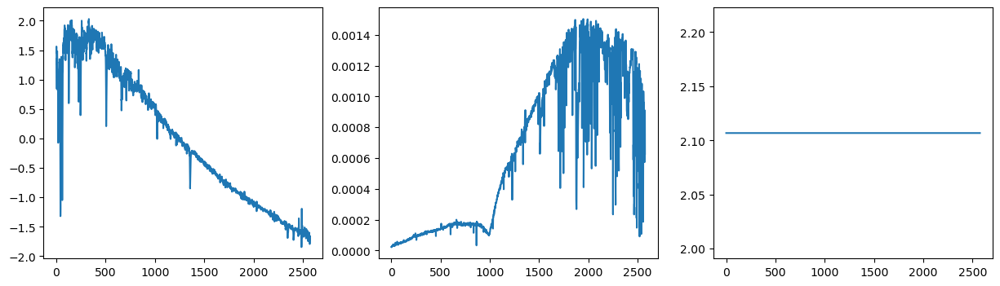

In [10]:
fig, axs = plt.subplots(1, 3, figsize=(15, 4))

axs[0].plot(s[0, :])
axs[1].plot(s[1, :])
axs[2].plot(s[2, :])

In [9]:
p, p_m, s, m, l = train_dataset[0]

In [11]:
s.shape

(3, 2575)

In [11]:
el = train_dataset.df.iloc[0]
spectra = train_dataset.readLRSFits(os.path.join(train_dataset.lamost_spec_dir, el['spec_filename'])) 

In [13]:
err = spectra[:, 2]

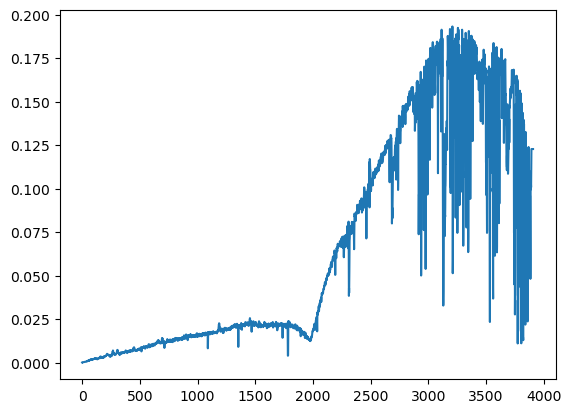

In [15]:
plt.plot(err)

In [16]:
photometry = train_dataset.get_vlc(el['name'])

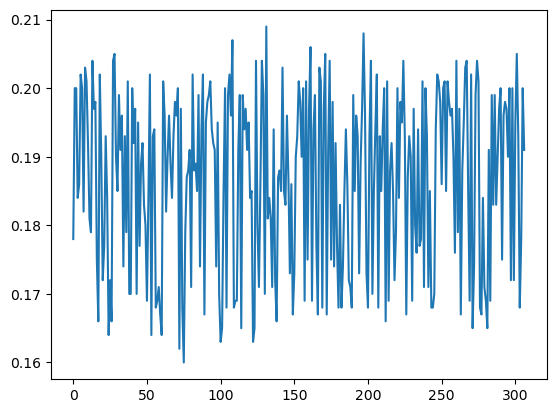

In [20]:
plt.plot(photometry[:, 2])

In [43]:
len(inds)

210

In [45]:
train_dataset.df

,mean_vmag,amplitude,period,phot_g_mean_mag,e_phot_g_mean_mag,lksl_statistic,rfr_score,phot_bp_mean_mag,e_phot_bp_mean_mag,phot_rp_mean_mag,...,w3_w4,pm,ruwe,id,target,name,spec_filename,l,b,org_period
0,0.468452,-0.123730,-0.750512,0.577753,0.337026,-1.109518,1.036339,0.480426,0.077119,0.622243,...,0.682490,-0.451806,-0.180783,EDR3 2117581746386552576,EW,ASASSN-VJ184120.05+445439.3,spec-57516-HD184435N434959B01_sp15-016.fits.gz,1.003911,0.444250,0.369614
1,0.377716,-0.273548,-0.705325,0.455826,-0.124239,-1.072690,1.036339,0.367259,-0.178151,0.488187,...,0.006407,-0.425981,1.996158,EDR3 2827427930745553152,EW,ASASSN-VJ233021.18+214240.3,spec-56967-EG232823N195308V01_sp11-063.fits.gz,0.356090,-1.547098,0.412779
2,0.318932,-0.273548,-0.669766,0.412862,0.311818,-1.146347,1.108638,0.278147,0.014382,0.485811,...,0.509394,0.712358,-0.125700,EDR3 925880840326498432,EW,ASASSN-VJ074727.40+433956.1,spec-57410-HD075322N454428V02_sp02-117.fits.gz,-0.895975,0.695969,0.450261
3,1.538395,-0.937028,0.714209,1.453767,-0.818067,1.836758,-1.711015,1.531617,-0.632357,1.390540,...,-0.998790,4.057670,-0.228108,EDR3 68317609532996480,ROT,ASASSN-VJ034302.91+244010.5,spec-59256-TD035052N235741K01_sp14-208.fits.gz,-0.852410,-1.120683,13.261893
4,0.509448,-0.252145,-0.791427,0.606532,0.093484,-0.667577,0.674845,0.502280,-0.058651,0.656728,...,0.823761,-0.727824,-0.238194,EDR3 648370741200605184,EW,ASASSN-VJ094203.63+290516.4,spec-59227-HD093848N300911B02_sp08-178.fits.gz,-0.821378,1.274705,0.334439
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17507,0.228431,-0.701599,0.065577,0.335048,-0.814205,0.289963,-0.265039,0.230633,-0.592953,0.372883,...,0.356480,0.101199,-0.195912,EDR3 885140571559287808,EA,ASASSN-VJ072316.79+283254.9,spec-57061-HD072233N294927V01_sp05-021.fits.gz,-0.878110,0.395289,2.716803
17508,-0.042041,11.219636,1.946378,-0.955821,5.891108,-0.630748,0.602546,-0.154367,7.401013,-1.210405,...,-1.401645,-0.727824,-0.262244,EDR3 3288382134693751808,M,ASASSN-VJ050308.19+071205.4,spec-58844-GAC074N07B1_sp06-185.fits.gz,-0.861132,-1.001258,269.525193
17509,-0.535388,-0.530379,1.237532,-1.080398,-0.458651,2.426014,-2.578601,-0.563563,-0.082413,-1.250584,...,-1.520406,-0.401516,-0.143156,EDR3 983259752271595520,SR,ASASSN-VJ072724.87+512834.7,spec-58176-HD073914N523358V03_sp10-028.fits.gz,-0.857725,0.639275,47.657608
17510,0.074214,-0.551781,-0.643729,0.235073,-0.251092,-1.109518,1.108638,0.047008,-0.295869,0.344791,...,0.367347,-0.382390,0.069030,EDR3 3996741504454016768,EW,ASASSN-VJ105927.24+255202.9,spec-57503-HD110344N254628V02_sp03-163.fits.gz,-0.708232,1.602304,0.479847


In [25]:
inds

[31, 64, 97, 110, 178, 205]

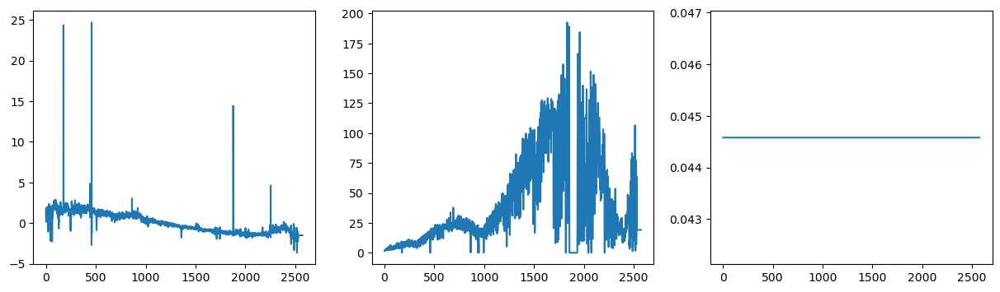

In [26]:
p, p_m, s, m, l = train_dataset[31]
fig, axs = plt.subplots(1, 3, figsize=(15, 4))

axs[0].plot(s[0, :])
axs[1].plot(s[1, :])
axs[2].plot(s[2, :])

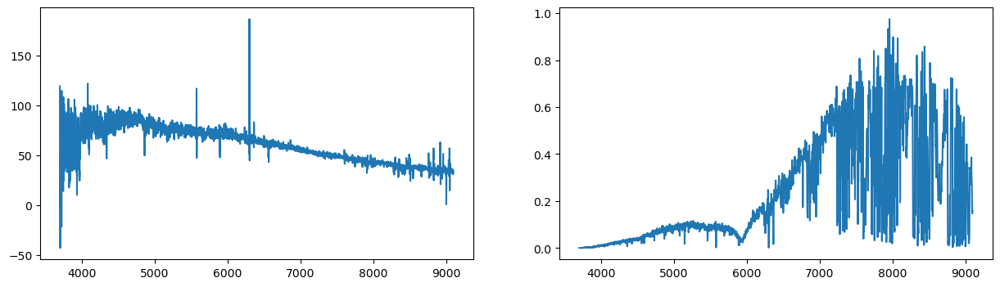

In [40]:
el = train_dataset.df.iloc[30]
spectra = train_dataset.readLRSFits(os.path.join(train_dataset.lamost_spec_dir, el['spec_filename'])) 
fig, axs = plt.subplots(1, 2, figsize=(15, 4))

axs[0].plot(spectra[:, 0], spectra[:, 1])
axs[1].plot(spectra[:, 0], spectra[:, 2])

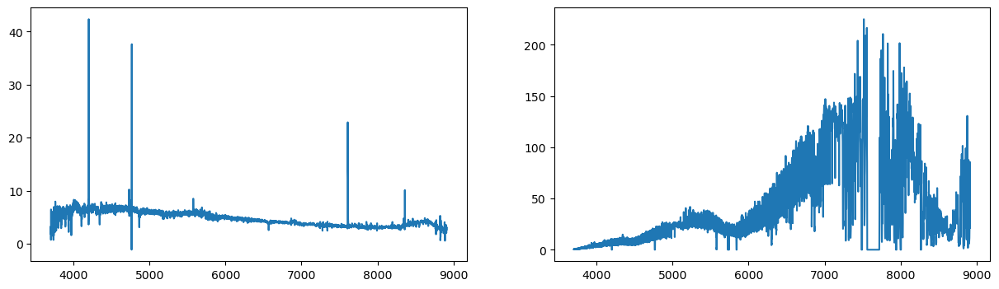

In [33]:
el = train_dataset.df.iloc[31]
spectra = train_dataset.readLRSFits(os.path.join(train_dataset.lamost_spec_dir, el['spec_filename'])) 
fig, axs = plt.subplots(1, 2, figsize=(15, 4))

axs[0].plot(spectra[:, 0], spectra[:, 1])
axs[1].plot(spectra[:, 0], spectra[:, 2])

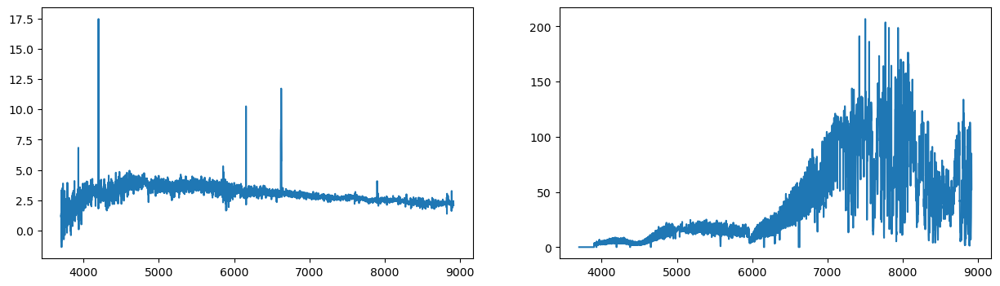

In [34]:
el = train_dataset.df.iloc[64]
spectra = train_dataset.readLRSFits(os.path.join(train_dataset.lamost_spec_dir, el['spec_filename'])) 
fig, axs = plt.subplots(1, 2, figsize=(15, 4))

axs[0].plot(spectra[:, 0], spectra[:, 1])
axs[1].plot(spectra[:, 0], spectra[:, 2])

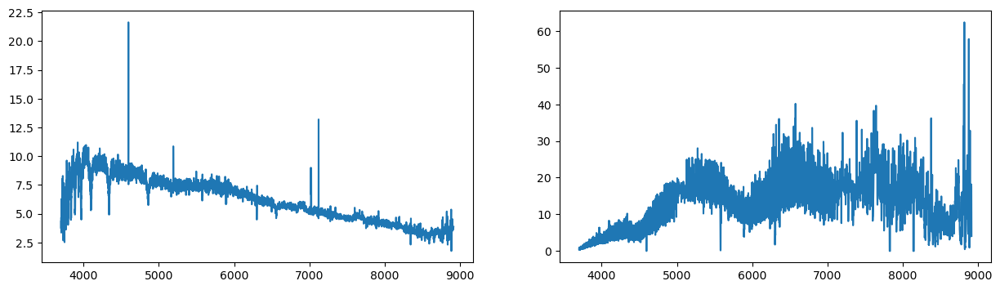

In [35]:
el = train_dataset.df.iloc[97]
spectra = train_dataset.readLRSFits(os.path.join(train_dataset.lamost_spec_dir, el['spec_filename'])) 
fig, axs = plt.subplots(1, 2, figsize=(15, 4))

axs[0].plot(spectra[:, 0], spectra[:, 1])
axs[1].plot(spectra[:, 0], spectra[:, 2])

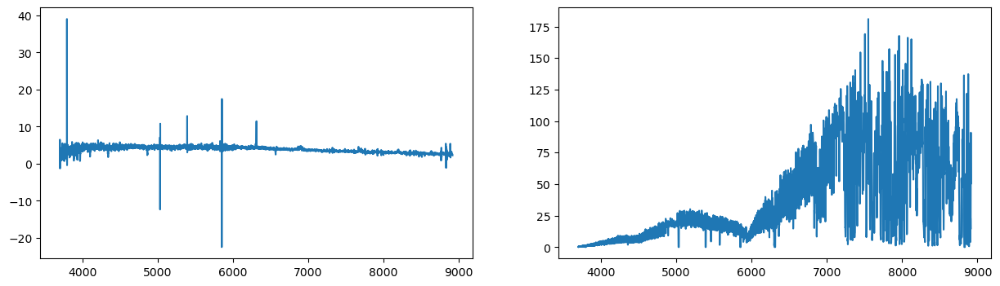

In [36]:
el = train_dataset.df.iloc[110]
spectra = train_dataset.readLRSFits(os.path.join(train_dataset.lamost_spec_dir, el['spec_filename'])) 
fig, axs = plt.subplots(1, 2, figsize=(15, 4))

axs[0].plot(spectra[:, 0], spectra[:, 1])
axs[1].plot(spectra[:, 0], spectra[:, 2])

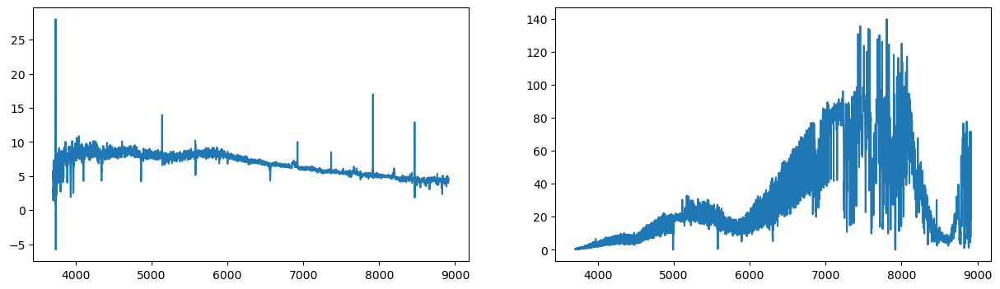

In [37]:
el = train_dataset.df.iloc[178]
spectra = train_dataset.readLRSFits(os.path.join(train_dataset.lamost_spec_dir, el['spec_filename'])) 
fig, axs = plt.subplots(1, 2, figsize=(15, 4))

axs[0].plot(spectra[:, 0], spectra[:, 1])
axs[1].plot(spectra[:, 0], spectra[:, 2])

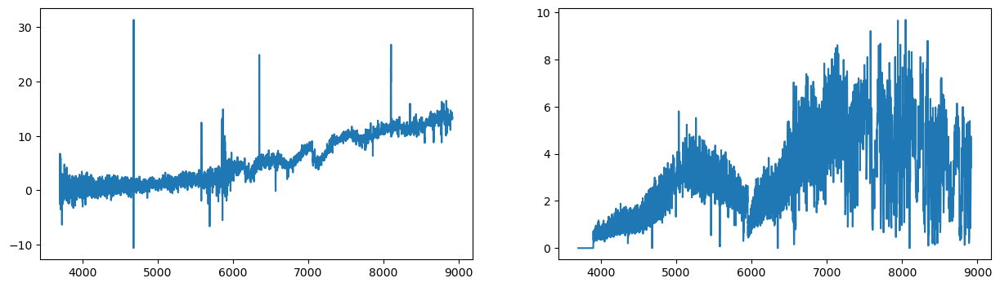

In [38]:
el = train_dataset.df.iloc[205]
spectra = train_dataset.readLRSFits(os.path.join(train_dataset.lamost_spec_dir, el['spec_filename'])) 
fig, axs = plt.subplots(1, 2, figsize=(15, 4))

axs[0].plot(spectra[:, 0], spectra[:, 1])
axs[1].plot(spectra[:, 0], spectra[:, 2])

In [30]:
spectra

array([[3.7000000e+03, 1.9114463e+00, 3.3208254e-01],
       [3.7008521e+03, 2.6917319e+00, 6.4872587e-01],
       [3.7017043e+03, 3.3005972e+00, 3.2935056e-01],
       ...,
       [8.9104922e+03, 2.6356559e+00, 8.5706352e+01],
       [8.9125449e+03, 2.6119807e+00, 5.9030968e+01],
       [8.9145967e+03, 3.0113773e+00, 2.1216213e+01]], dtype=float32)

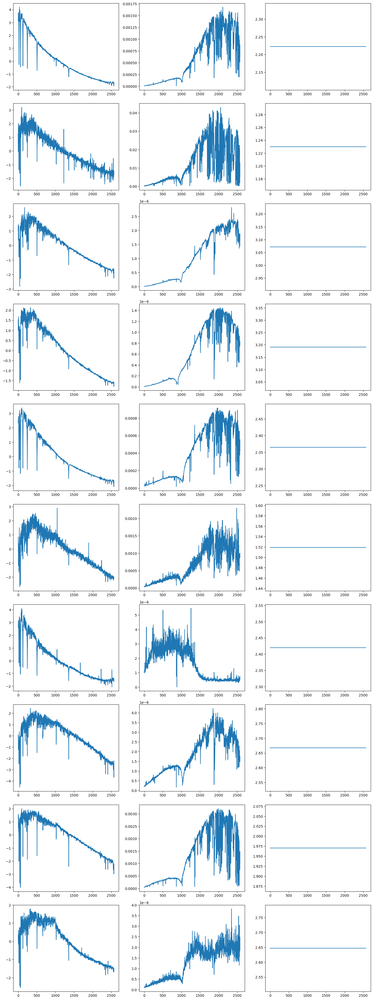

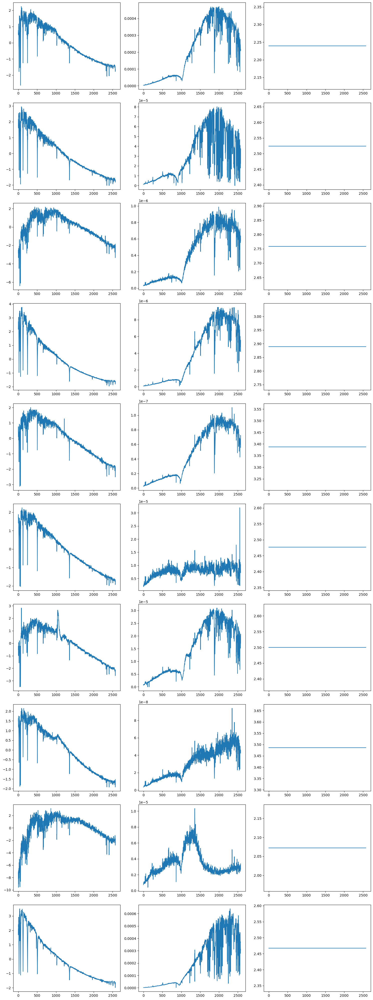

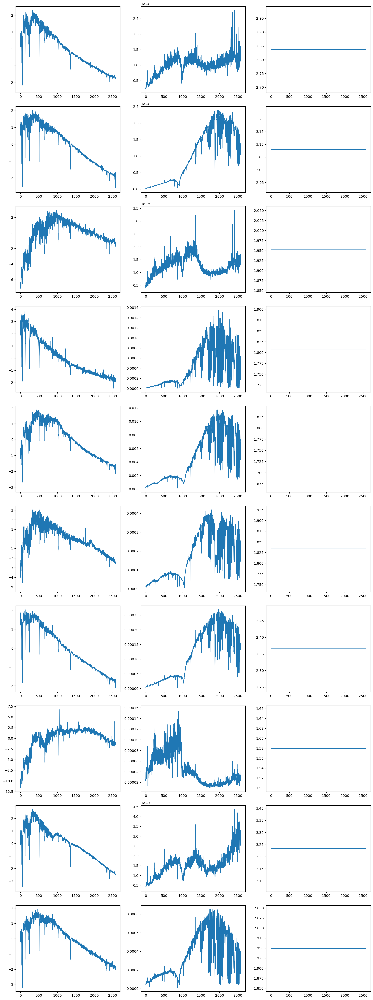

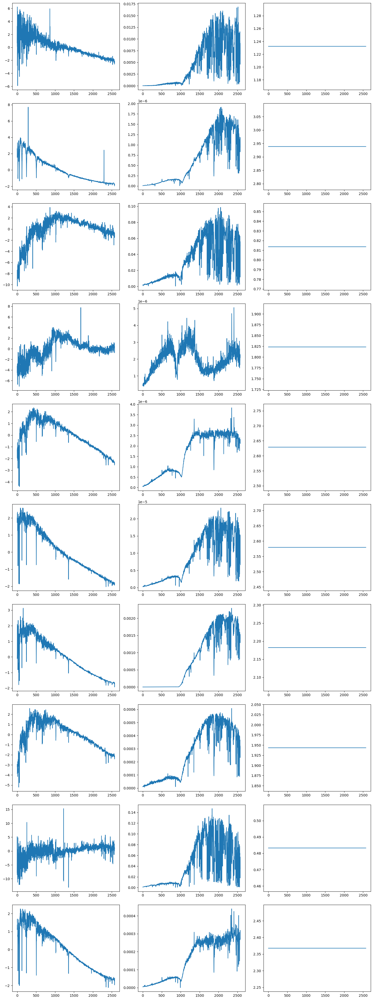

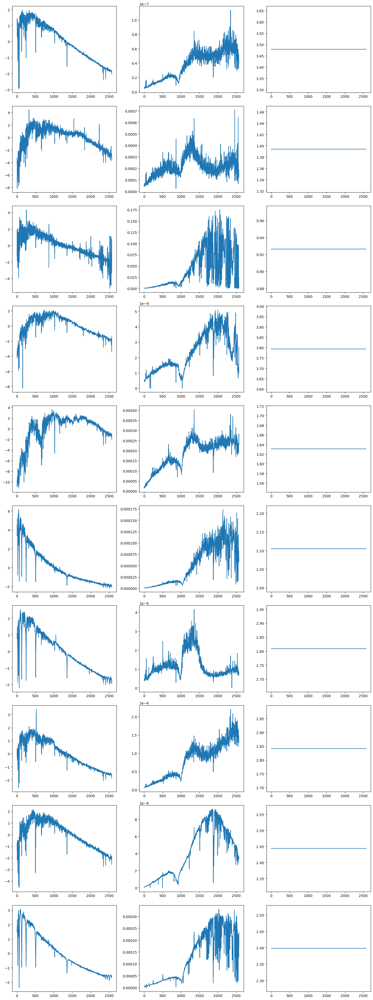

...

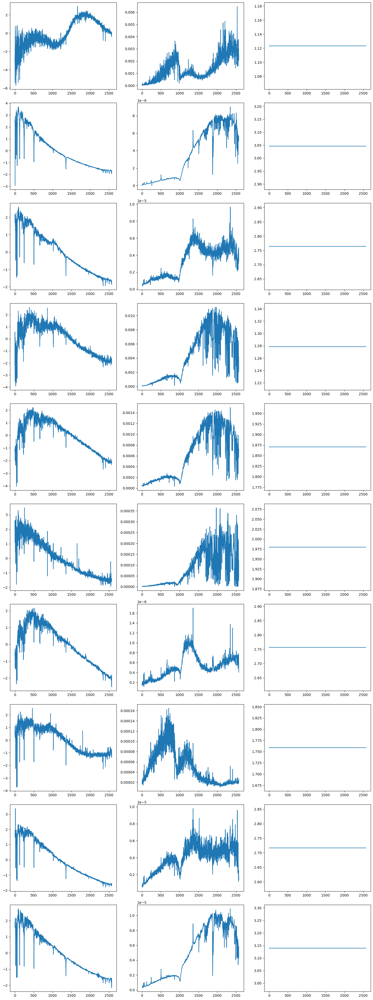

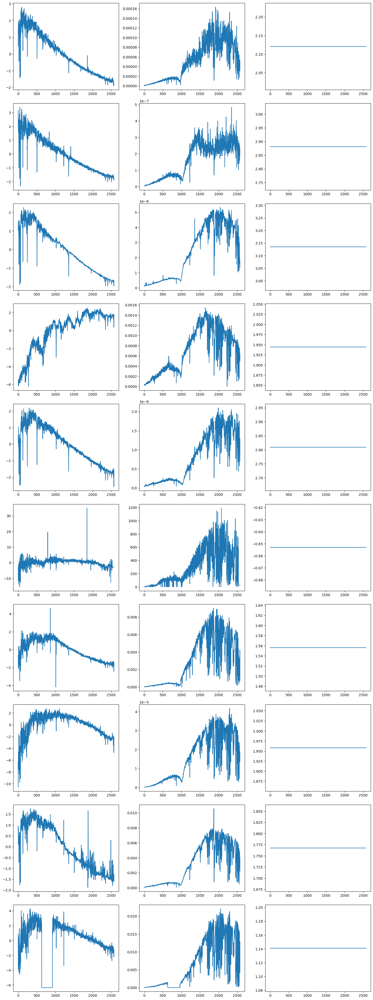

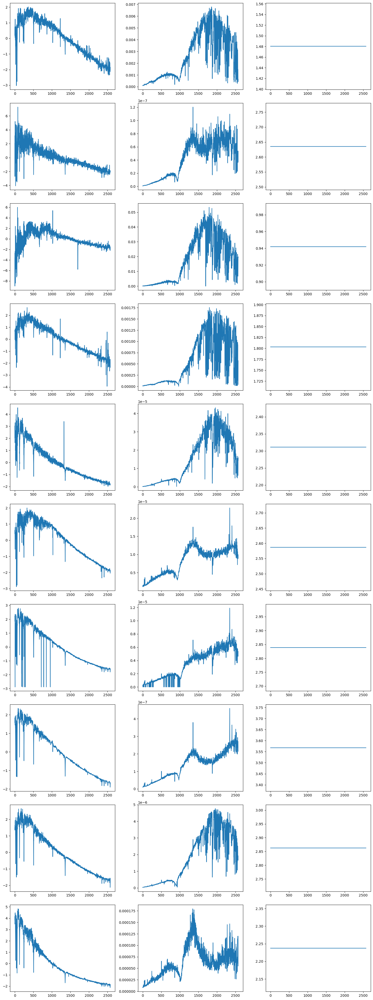

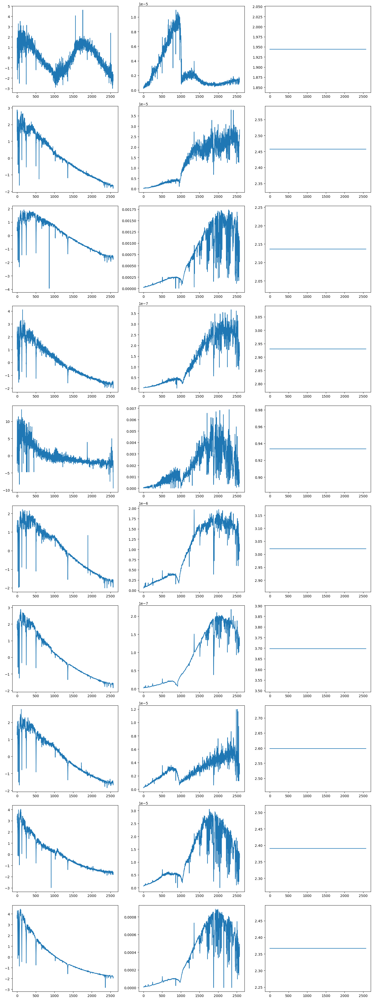

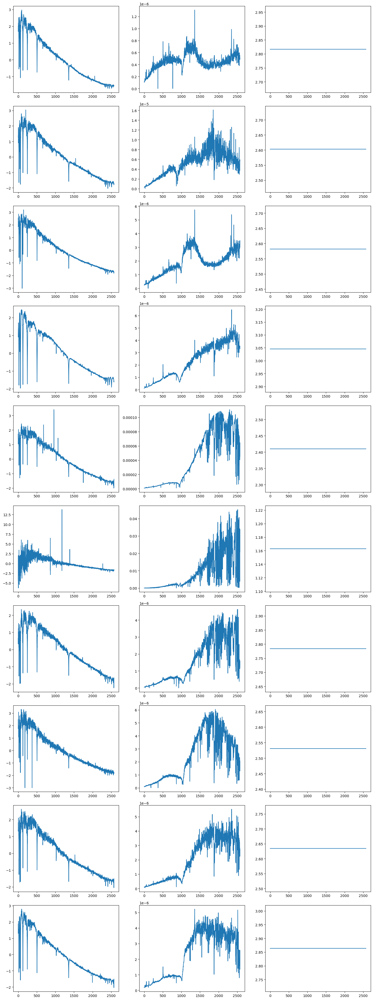

KeyboardInterrupt: 

In [22]:
start_idx = 25 * 512
end_idx = 26 * 512
batch_size = 10  # Number of i's to plot at a time

for batch_start in range(start_idx, end_idx, batch_size):
    batch_end = min(batch_start + batch_size, end_idx)
    
    # Create subplots
    fig, axs = plt.subplots(batch_end - batch_start, 3, figsize=(15, (batch_end - batch_start) * 4))
    
    for i in range(batch_start, batch_end):
        p, p_m, s, m, l = train_dataset[i]

        axs[i - batch_start, 0].plot(s[0, :])
        axs[i - batch_start, 1].plot(s[1, :])
        axs[i - batch_start, 2].plot(s[2, :])

    plt.tight_layout()
    plt.show()